In [6]:
import torch
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

import torch.nn.functional as F
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt

from torch import nn
import math

Hyperparameters we need

In [2]:
device = 'cuda'

dataroot = '../data/face_data'

image_size = 128

batch_size = 96

We'll use fake face data scraped from thispersondoesnotexist.com to train our model. Here's what they look like

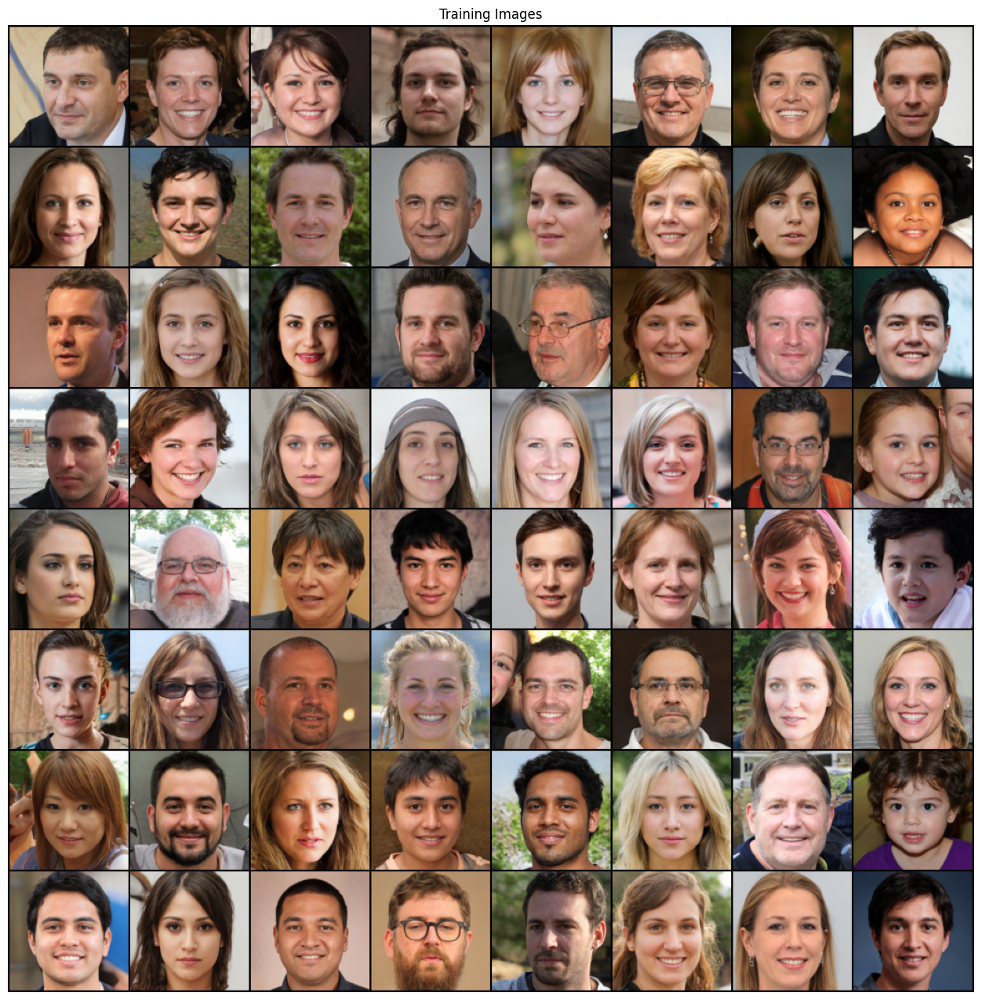

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = datasets.ImageFolder(
    root=dataroot,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(
    dataset, 
    batch_size=batch_size,
    shuffle=True, 
    num_workers=2
)

# Plot some training images
batch = next(iter(dataloader))
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

The gist of diffusion models is essentially forward and backward diffusion processes. We turn images into pure noise by forward diffusion, and use a backward diffusion process to turn random noise into images. Our neural network is used in the backward diffusion process. Instead of learning about images like in GANs, our model learn about noise distribution and how to reerse them.

We start with the forward diffusion process, which gradually adds random noise to an image, making it a complete image of noise by the end of certain amount of timestep. This is a Markov process, where the state of the current image depends only on the previous image. We denote the process as q.
$$
q(x_{i:T}|x_0)=\prod_{t=a}^{T} q(x_t|x_t-1) 
$$

Where x<sub>0</sub> = original image, T = total time step. And x<sub>1</sub> to x<sub>T</sub> are more and more noisy version of x<sub>0</sub>.
The way noise is sampled at time t is described by 
$$
\begin{align*}
q(x_t|x_{t-1}) &=N(x_t;\sqrt{1-{\beta}_t}x_{t-1}, {{\beta}_t}I) \\
&=\sqrt{1-{{\beta}_t}}x_{t-1}+\sqrt{{\beta}_t}\epsilon
\end{align*}
$$

$$ {\text{Where }} x_t=\text{output}, \sqrt{1-{{\beta}_t}}=\text{mean}, {{\beta}_t}I =\text{fixed variance}, {\epsilon\sim}N(0,1) \text{ meaning avg 0 and std 1} $$

Variance at time t is bascially how much noise we'd like to generate. Further, we define the following
$$
{\alpha}_t=1-{\beta}_t \\
{\overline{{\alpha}}_t} = \prod_{i=1}^{t} {\alpha}_t \\
$$
Combining this into our definition of q, we have
$$
\begin{align*}
q(x_t|x_{t-1})&=\sqrt{1-{{\beta}_t}}x_{t-1}+\sqrt{{\beta}_t}\epsilon \\
&=\sqrt{{\alpha}_t}x_{t-1}+\sqrt{1-{\alpha}_t}\epsilon \\
&=\sqrt{{\alpha}_t{\alpha}_{t-1}}x_{t-2}+\sqrt{1-{\alpha}_t{\alpha}_{t-1}}\epsilon \\
&=\sqrt{{\alpha}_t{\alpha}_{t-1}{\alpha}_{t-2}}x_{t-3}+\sqrt{1-{\alpha}_t{\alpha}_{t-1}{\alpha}_{t-2}}\epsilon \\
&=\sqrt{\overline{{\alpha}}_t}x_0+\sqrt{1-\overline{{\alpha}}_t}\epsilon \\
\end{align*}
$$

According to above, we can define the parameters and the forward diffusion process

In [4]:
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

T = 300

beta = linear_beta_schedule(timesteps=T).to(device)
alpha = 1 - beta
alpha_hat = torch.cumprod(alpha, axis=0)

alpha_hat_mean_term = torch.sqrt(alpha_hat)
alpha_hat_vari_term = torch.sqrt(1 - alpha_hat)

def forward_diffusion(x_0, timestep):
    x_0 = x_0.to(device)
    epsilon = torch.randn_like(x_0, device=device)
    return alpha_hat_mean_term[timestep] * x_0 + alpha_hat_vari_term[timestep] * epsilon, epsilon

To put the forward diffusion process in action and see the outcome

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[0, 30, 60, 90, 120, 150, 180, 210, 240, 270]


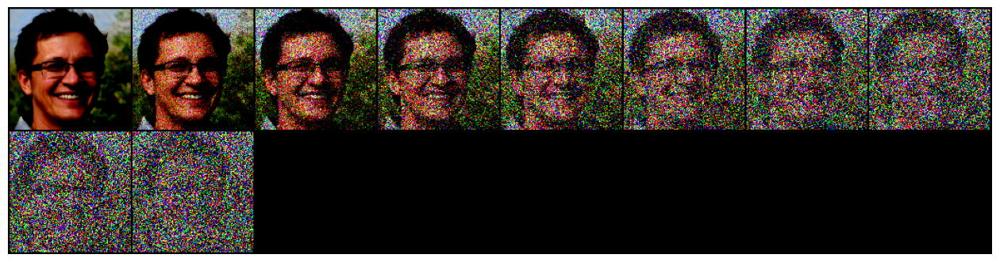

In [5]:
# Simulate forward diffusion
image = next(iter(dataloader))[0][0, :, :, :]

num_images = 10
timesteps = list(range(0, T, int(T / num_images)))
print(timesteps)

images = [forward_diffusion(image, timestep)[0] for timestep in timesteps]

plt.figure(figsize=(16,16))
plt.axis('off')
grid = vutils.make_grid(images)
plt.imshow((grid.permute(1, 2, 0)).cpu())

To accomadate with my personal hardware, I'm going to use a simplified U-net with sinusoidal position embedding for timestep. Keep in mind that the model architecture here is by **NO MEANS** the only option and is only intended for playing with generative diffusion. There are much improvements we could incorporate in the model, some of the ones I can think of include
<ul>
    <li>Residual Blocks</li>
    <li>Attention</li>
    <li>Batch / Group Normalization</li>
    <li>Other conditioning s.a. texts</li>
</ul>

In [7]:
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()
        
    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 1 
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )
        
        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        self.output = nn.Conv2d(up_channels[-1], 3, out_dim)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)           
            x = up(x, t)
        return self.output(x)

And our loss function is defined as

In [8]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion(x_0, t)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

The Backward Diffusion Process is recovering an image from random noise, and using the same symbols, the process is defined as
$$
X_{t-1} = \frac{1}{\sqrt{{\alpha}_t}}\Bigl(X_t - \frac{1-{\alpha}_t}{\sqrt{1-{\overline{{\alpha}}_t}}}M(X_t, t)\Bigl) + {\sigma}_t\epsilon \\
$$ 
Where M(x, t) is the forward function of our model.

In [8]:
@torch.no_grad()
def backward_diffusion(model, x, t):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. 
    Applies noise to this image, if we are not in the last step yet.
    """

    y_hat = model(x, t)
    sigma = torch.sqrt(beta[t] * (1 - alpha_hat[t - 1]) / (1 - alpha_hat[t]))
    
    if t != 0:
        epsilon = torch.randn_like(x)
    else:
        epsilon = torch.zeros_like(x)

    x_prev = torch.sqrt(1 / alpha[t]) * (x - beta[t] * y_hat / torch.sqrt(1 - alpha_hat[t])) + sigma * epsilon
    return x_prev

@torch.no_grad()
def sample_plot_image(model):
    num_images = 10
    image = torch.randn((1, 3, image_size, image_size), device=device)
    images = []

    for i in range(0, T)[::-1]:
        t = torch.tensor([i], device=device)
        image = backward_diffusion(model, image, t)
        if i % int(T / num_images) == 0:
            image_copy = image.view(3, 128, 128)
            images.append(image_copy)

    plt.figure(figsize=(16,16))
    plt.axis('off')
    grid = vutils.make_grid(images, normalize=True)
    plt.imshow(grid.permute(1, 2, 0).cpu())
    plt.show()

Finanlly, we go ahead and train our model.

E0S0
Epoch 0 | step 000 Loss: 0.813046932220459 


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


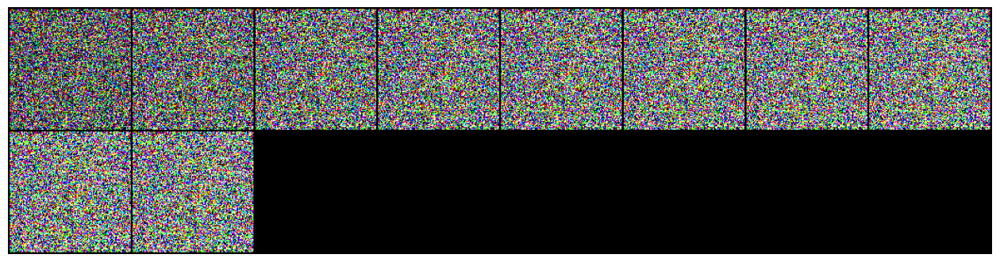

E0S1
E0S2
E0S3
E0S4
E0S5
E0S6
E0S7
E0S8
E0S9
E0S10
E0S11
E0S12
E0S13
E0S14
E0S15
E0S16
E0S17
E0S18
E0S19
E0S20
E0S21
E0S22
E0S23
E0S24
E0S25
E0S26
E0S27
E0S28
E0S29
E0S30
E0S31
E0S32
E0S33
E0S34
E0S35
E0S36
E0S37
E0S38
E0S39
E0S40
E0S41
E0S42
E0S43
E0S44
E0S45
E0S46
E0S47
E0S48
E0S49
E0S50
E0S51
E0S52
E0S53
E0S54
E0S55
E0S56
E0S57
E0S58
E0S59
E0S60
E0S61
E0S62
E0S63
E0S64
E0S65
E0S66
E0S67
E0S68
E0S69
E0S70
E0S71
E0S72
E0S73
E0S74
E0S75
E0S76
E0S77
E0S78
E0S79
E0S80
E0S81
E0S82
E0S83
E0S84
E0S85
E0S86
E0S87
E0S88
E0S89
E0S90
E0S91
E0S92
E0S93
E0S94
E0S95
E0S96
E0S97
E0S98
E0S99
E0S100
E0S101
E0S102
E0S103
E0S104
E0S105
E0S106
E0S107
E0S108
E0S109
E0S110
E0S111
E0S112
E0S113
E0S114
E0S115
E0S116
E0S117
E0S118
E0S119
E0S120
E0S121
E0S122
E0S123
E0S124
E0S125
E0S126
E0S127
E0S128
E0S129
E0S130
E0S131
E0S132
E0S133
E0S134
E0S135
E0S136
E0S137
E0S138
E0S139
E0S140
E0S141
E0S142
E0S143
E0S144
E0S145
E0S146
E0S147
E0S148
E0S149
E0S150
E0S151
E0S152
E0S153
E0S154
E0S155
E0S156
E0S157
E0S158
E0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


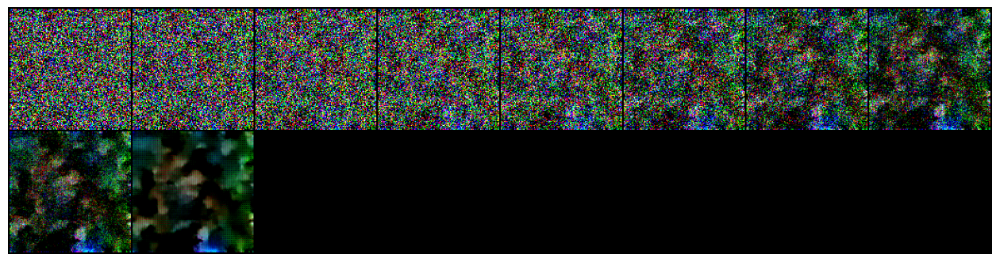

E5S1
E5S2
E5S3
E5S4
E5S5
E5S6
E5S7
E5S8
E5S9
E5S10
E5S11
E5S12
E5S13
E5S14
E5S15
E5S16
E5S17
E5S18
E5S19
E5S20
E5S21
E5S22
E5S23
E5S24
E5S25
E5S26
E5S27
E5S28
E5S29
E5S30
E5S31
E5S32
E5S33
E5S34
E5S35
E5S36
E5S37
E5S38
E5S39
E5S40
E5S41
E5S42
E5S43
E5S44
E5S45
E5S46
E5S47
E5S48
E5S49
E5S50
E5S51
E5S52
E5S53
E5S54
E5S55
E5S56
E5S57
E5S58
E5S59
E5S60
E5S61
E5S62
E5S63
E5S64
E5S65
E5S66
E5S67
E5S68
E5S69
E5S70
E5S71
E5S72
E5S73
E5S74
E5S75
E5S76
E5S77
E5S78
E5S79
E5S80
E5S81
E5S82
E5S83
E5S84
E5S85
E5S86
E5S87
E5S88
E5S89
E5S90
E5S91
E5S92
E5S93
E5S94
E5S95
E5S96
E5S97
E5S98
E5S99
E5S100
E5S101
E5S102
E5S103
E5S104
E5S105
E5S106
E5S107
E5S108
E5S109
E5S110
E5S111
E5S112
E5S113
E5S114
E5S115
E5S116
E5S117
E5S118
E5S119
E5S120
E5S121
E5S122
E5S123
E5S124
E5S125
E5S126
E5S127
E5S128
E5S129
E5S130
E5S131
E5S132
E5S133
E5S134
E5S135
E5S136
E5S137
E5S138
E5S139
E5S140
E5S141
E5S142
E5S143
E5S144
E5S145
E5S146
E5S147
E5S148
E5S149
E5S150
E5S151
E5S152
E5S153
E5S154
E5S155
E5S156
E5S157
E5S158
E5

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


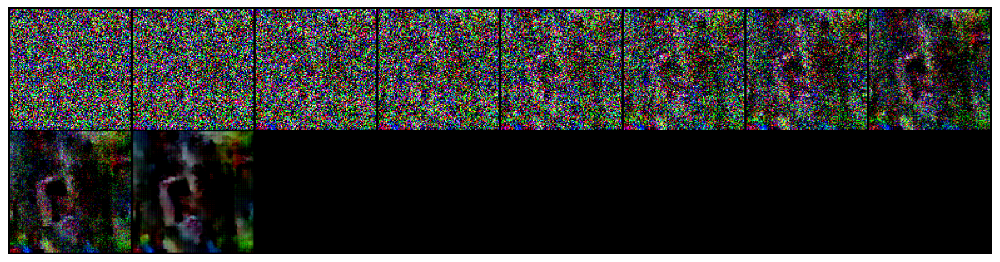

E10S1
E10S2
E10S3
E10S4
E10S5
E10S6
E10S7
E10S8
E10S9
E10S10
E10S11
E10S12
E10S13
E10S14
E10S15
E10S16
E10S17
E10S18
E10S19
E10S20
E10S21
E10S22
E10S23
E10S24
E10S25
E10S26
E10S27
E10S28
E10S29
E10S30
E10S31
E10S32
E10S33
E10S34
E10S35
E10S36
E10S37
E10S38
E10S39
E10S40
E10S41
E10S42
E10S43
E10S44
E10S45
E10S46
E10S47
E10S48
E10S49
E10S50
E10S51
E10S52
E10S53
E10S54
E10S55
E10S56
E10S57
E10S58
E10S59
E10S60
E10S61
E10S62
E10S63
E10S64
E10S65
E10S66
E10S67
E10S68
E10S69
E10S70
E10S71
E10S72
E10S73
E10S74
E10S75
E10S76
E10S77
E10S78
E10S79
E10S80
E10S81
E10S82
E10S83
E10S84
E10S85
E10S86
E10S87
E10S88
E10S89
E10S90
E10S91
E10S92
E10S93
E10S94
E10S95
E10S96
E10S97
E10S98
E10S99
E10S100
E10S101
E10S102
E10S103
E10S104
E10S105
E10S106
E10S107
E10S108
E10S109
E10S110
E10S111
E10S112
E10S113
E10S114
E10S115
E10S116
E10S117
E10S118
E10S119
E10S120
E10S121
E10S122
E10S123
E10S124
E10S125
E10S126
E10S127
E10S128
E10S129
E10S130
E10S131
E10S132
E10S133
E10S134
E10S135
E10S136
E10S137
E10S138
E10S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


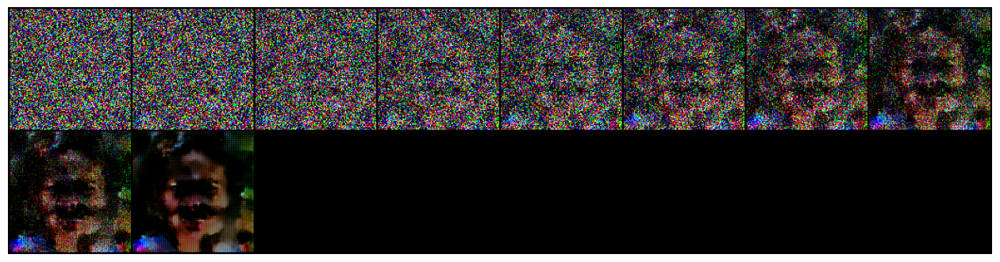

E15S1
E15S2
E15S3
E15S4
E15S5
E15S6
E15S7
E15S8
E15S9
E15S10
E15S11
E15S12
E15S13
E15S14
E15S15
E15S16
E15S17
E15S18
E15S19
E15S20
E15S21
E15S22
E15S23
E15S24
E15S25
E15S26
E15S27
E15S28
E15S29
E15S30
E15S31
E15S32
E15S33
E15S34
E15S35
E15S36
E15S37
E15S38
E15S39
E15S40
E15S41
E15S42
E15S43
E15S44
E15S45
E15S46
E15S47
E15S48
E15S49
E15S50
E15S51
E15S52
E15S53
E15S54
E15S55
E15S56
E15S57
E15S58
E15S59
E15S60
E15S61
E15S62
E15S63
E15S64
E15S65
E15S66
E15S67
E15S68
E15S69
E15S70
E15S71
E15S72
E15S73
E15S74
E15S75
E15S76
E15S77
E15S78
E15S79
E15S80
E15S81
E15S82
E15S83
E15S84
E15S85
E15S86
E15S87
E15S88
E15S89
E15S90
E15S91
E15S92
E15S93
E15S94
E15S95
E15S96
E15S97
E15S98
E15S99
E15S100
E15S101
E15S102
E15S103
E15S104
E15S105
E15S106
E15S107
E15S108
E15S109
E15S110
E15S111
E15S112
E15S113
E15S114
E15S115
E15S116
E15S117
E15S118
E15S119
E15S120
E15S121
E15S122
E15S123
E15S124
E15S125
E15S126
E15S127
E15S128
E15S129
E15S130
E15S131
E15S132
E15S133
E15S134
E15S135
E15S136
E15S137
E15S138
E15S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


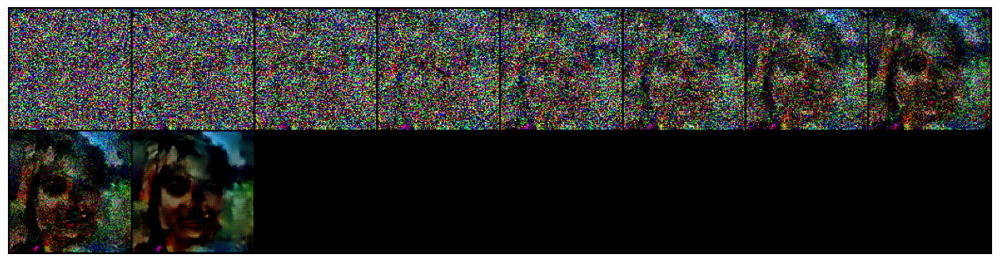

E20S1
E20S2
E20S3
E20S4
E20S5
E20S6
E20S7
E20S8
E20S9
E20S10
E20S11
E20S12
E20S13
E20S14
E20S15
E20S16
E20S17
E20S18
E20S19
E20S20
E20S21
E20S22
E20S23
E20S24
E20S25
E20S26
E20S27
E20S28
E20S29
E20S30
E20S31
E20S32
E20S33
E20S34
E20S35
E20S36
E20S37
E20S38
E20S39
E20S40
E20S41
E20S42
E20S43
E20S44
E20S45
E20S46
E20S47
E20S48
E20S49
E20S50
E20S51
E20S52
E20S53
E20S54
E20S55
E20S56
E20S57
E20S58
E20S59
E20S60
E20S61
E20S62
E20S63
E20S64
E20S65
E20S66
E20S67
E20S68
E20S69
E20S70
E20S71
E20S72
E20S73
E20S74
E20S75
E20S76
E20S77
E20S78
E20S79
E20S80
E20S81
E20S82
E20S83
E20S84
E20S85
E20S86
E20S87
E20S88
E20S89
E20S90
E20S91
E20S92
E20S93
E20S94
E20S95
E20S96
E20S97
E20S98
E20S99
E20S100
E20S101
E20S102
E20S103
E20S104
E20S105
E20S106
E20S107
E20S108
E20S109
E20S110
E20S111
E20S112
E20S113
E20S114
E20S115
E20S116
E20S117
E20S118
E20S119
E20S120
E20S121
E20S122
E20S123
E20S124
E20S125
E20S126
E20S127
E20S128
E20S129
E20S130
E20S131
E20S132
E20S133
E20S134
E20S135
E20S136
E20S137
E20S138
E20S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


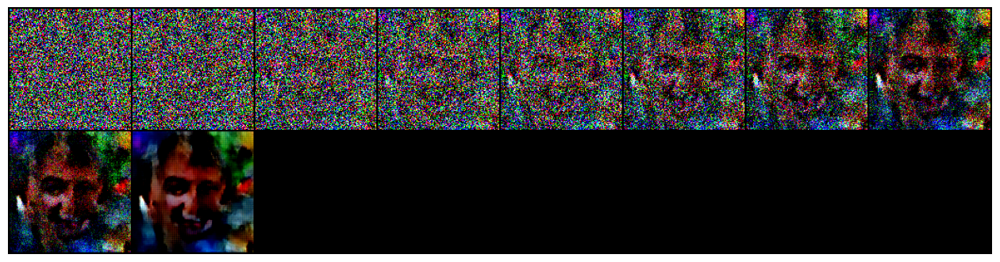

E25S1
E25S2
E25S3
E25S4
E25S5
E25S6
E25S7
E25S8
E25S9
E25S10
E25S11
E25S12
E25S13
E25S14
E25S15
E25S16
E25S17
E25S18
E25S19
E25S20
E25S21
E25S22
E25S23
E25S24
E25S25
E25S26
E25S27
E25S28
E25S29
E25S30
E25S31
E25S32
E25S33
E25S34
E25S35
E25S36
E25S37
E25S38
E25S39
E25S40
E25S41
E25S42
E25S43
E25S44
E25S45
E25S46
E25S47
E25S48
E25S49
E25S50
E25S51
E25S52
E25S53
E25S54
E25S55
E25S56
E25S57
E25S58
E25S59
E25S60
E25S61
E25S62
E25S63
E25S64
E25S65
E25S66
E25S67
E25S68
E25S69
E25S70
E25S71
E25S72
E25S73
E25S74
E25S75
E25S76
E25S77
E25S78
E25S79
E25S80
E25S81
E25S82
E25S83
E25S84
E25S85
E25S86
E25S87
E25S88
E25S89
E25S90
E25S91
E25S92
E25S93
E25S94
E25S95
E25S96
E25S97
E25S98
E25S99
E25S100
E25S101
E25S102
E25S103
E25S104
E25S105
E25S106
E25S107
E25S108
E25S109
E25S110
E25S111
E25S112
E25S113
E25S114
E25S115
E25S116
E25S117
E25S118
E25S119
E25S120
E25S121
E25S122
E25S123
E25S124
E25S125
E25S126
E25S127
E25S128
E25S129
E25S130
E25S131
E25S132
E25S133
E25S134
E25S135
E25S136
E25S137
E25S138
E25S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


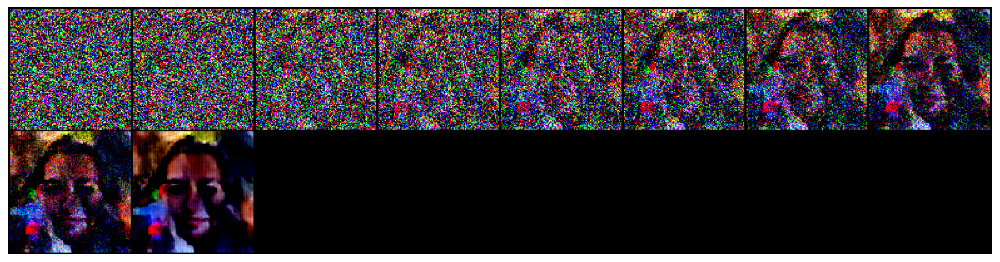

E30S1
E30S2
E30S3
E30S4
E30S5
E30S6
E30S7
E30S8
E30S9
E30S10
E30S11
E30S12
E30S13
E30S14
E30S15
E30S16
E30S17
E30S18
E30S19
E30S20
E30S21
E30S22
E30S23
E30S24
E30S25
E30S26
E30S27
E30S28
E30S29
E30S30
E30S31
E30S32
E30S33
E30S34
E30S35
E30S36
E30S37
E30S38
E30S39
E30S40
E30S41
E30S42
E30S43
E30S44
E30S45
E30S46
E30S47
E30S48
E30S49
E30S50
E30S51
E30S52
E30S53
E30S54
E30S55
E30S56
E30S57
E30S58
E30S59
E30S60
E30S61
E30S62
E30S63
E30S64
E30S65
E30S66
E30S67
E30S68
E30S69
E30S70
E30S71
E30S72
E30S73
E30S74
E30S75
E30S76
E30S77
E30S78
E30S79
E30S80
E30S81
E30S82
E30S83
E30S84
E30S85
E30S86
E30S87
E30S88
E30S89
E30S90
E30S91
E30S92
E30S93
E30S94
E30S95
E30S96
E30S97
E30S98
E30S99
E30S100
E30S101
E30S102
E30S103
E30S104
E30S105
E30S106
E30S107
E30S108
E30S109
E30S110
E30S111
E30S112
E30S113
E30S114
E30S115
E30S116
E30S117
E30S118
E30S119
E30S120
E30S121
E30S122
E30S123
E30S124
E30S125
E30S126
E30S127
E30S128
E30S129
E30S130
E30S131
E30S132
E30S133
E30S134
E30S135
E30S136
E30S137
E30S138
E30S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


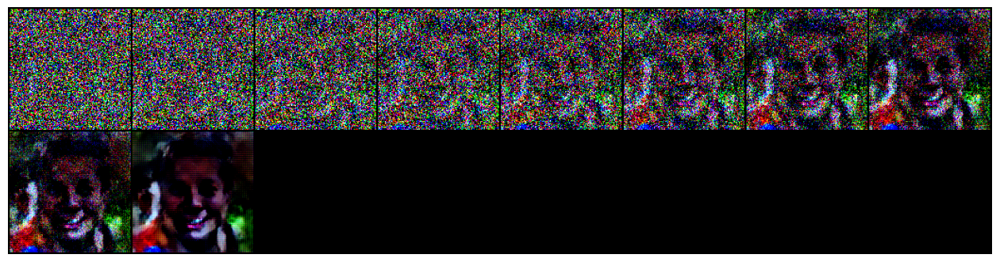

E35S1
E35S2
E35S3
E35S4
E35S5
E35S6
E35S7
E35S8
E35S9
E35S10
E35S11
E35S12
E35S13
E35S14
E35S15
E35S16
E35S17
E35S18
E35S19
E35S20
E35S21
E35S22
E35S23
E35S24
E35S25
E35S26
E35S27
E35S28
E35S29
E35S30
E35S31
E35S32
E35S33
E35S34
E35S35
E35S36
E35S37
E35S38
E35S39
E35S40
E35S41
E35S42
E35S43
E35S44
E35S45
E35S46
E35S47
E35S48
E35S49
E35S50
E35S51
E35S52
E35S53
E35S54
E35S55
E35S56
E35S57
E35S58
E35S59
E35S60
E35S61
E35S62
E35S63
E35S64
E35S65
E35S66
E35S67
E35S68
E35S69
E35S70
E35S71
E35S72
E35S73
E35S74
E35S75
E35S76
E35S77
E35S78
E35S79
E35S80
E35S81
E35S82
E35S83
E35S84
E35S85
E35S86
E35S87
E35S88
E35S89
E35S90
E35S91
E35S92
E35S93
E35S94
E35S95
E35S96
E35S97
E35S98
E35S99
E35S100
E35S101
E35S102
E35S103
E35S104
E35S105
E35S106
E35S107
E35S108
E35S109
E35S110
E35S111
E35S112
E35S113
E35S114
E35S115
E35S116
E35S117
E35S118
E35S119
E35S120
E35S121
E35S122
E35S123
E35S124
E35S125
E35S126
E35S127
E35S128
E35S129
E35S130
E35S131
E35S132
E35S133
E35S134
E35S135
E35S136
E35S137
E35S138
E35S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


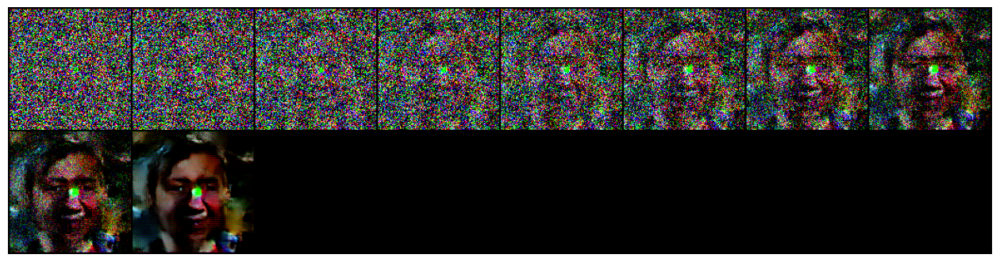

E40S1
E40S2
E40S3
E40S4
E40S5
E40S6
E40S7
E40S8
E40S9
E40S10
E40S11
E40S12
E40S13
E40S14
E40S15
E40S16
E40S17
E40S18
E40S19
E40S20
E40S21
E40S22
E40S23
E40S24
E40S25
E40S26
E40S27
E40S28
E40S29
E40S30
E40S31
E40S32
E40S33
E40S34
E40S35
E40S36
E40S37
E40S38
E40S39
E40S40
E40S41
E40S42
E40S43
E40S44
E40S45
E40S46
E40S47
E40S48
E40S49
E40S50
E40S51
E40S52
E40S53
E40S54
E40S55
E40S56
E40S57
E40S58
E40S59
E40S60
E40S61
E40S62
E40S63
E40S64
E40S65
E40S66
E40S67
E40S68
E40S69
E40S70
E40S71
E40S72
E40S73
E40S74
E40S75
E40S76
E40S77
E40S78
E40S79
E40S80
E40S81
E40S82
E40S83
E40S84
E40S85
E40S86
E40S87
E40S88
E40S89
E40S90
E40S91
E40S92
E40S93
E40S94
E40S95
E40S96
E40S97
E40S98
E40S99
E40S100
E40S101
E40S102
E40S103
E40S104
E40S105
E40S106
E40S107
E40S108
E40S109
E40S110
E40S111
E40S112
E40S113
E40S114
E40S115
E40S116
E40S117
E40S118
E40S119
E40S120
E40S121
E40S122
E40S123
E40S124
E40S125
E40S126
E40S127
E40S128
E40S129
E40S130
E40S131
E40S132
E40S133
E40S134
E40S135
E40S136
E40S137
E40S138
E40S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


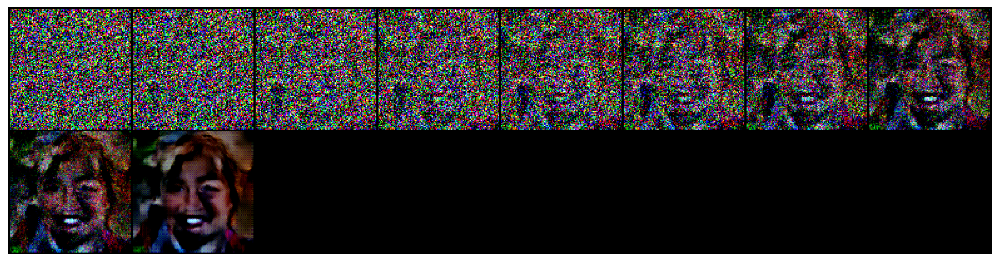

E45S1
E45S2
E45S3
E45S4
E45S5
E45S6
E45S7
E45S8
E45S9
E45S10
E45S11
E45S12
E45S13
E45S14
E45S15
E45S16
E45S17
E45S18
E45S19
E45S20
E45S21
E45S22
E45S23
E45S24
E45S25
E45S26
E45S27
E45S28
E45S29
E45S30
E45S31
E45S32
E45S33
E45S34
E45S35
E45S36
E45S37
E45S38
E45S39
E45S40
E45S41
E45S42
E45S43
E45S44
E45S45
E45S46
E45S47
E45S48
E45S49
E45S50
E45S51
E45S52
E45S53
E45S54
E45S55
E45S56
E45S57
E45S58
E45S59
E45S60
E45S61
E45S62
E45S63
E45S64
E45S65
E45S66
E45S67
E45S68
E45S69
E45S70
E45S71
E45S72
E45S73
E45S74
E45S75
E45S76
E45S77
E45S78
E45S79
E45S80
E45S81
E45S82
E45S83
E45S84
E45S85
E45S86
E45S87
E45S88
E45S89
E45S90
E45S91
E45S92
E45S93
E45S94
E45S95
E45S96
E45S97
E45S98
E45S99
E45S100
E45S101
E45S102
E45S103
E45S104
E45S105
E45S106
E45S107
E45S108
E45S109
E45S110
E45S111
E45S112
E45S113
E45S114
E45S115
E45S116
E45S117
E45S118
E45S119
E45S120
E45S121
E45S122
E45S123
E45S124
E45S125
E45S126
E45S127
E45S128
E45S129
E45S130
E45S131
E45S132
E45S133
E45S134
E45S135
E45S136
E45S137
E45S138
E45S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


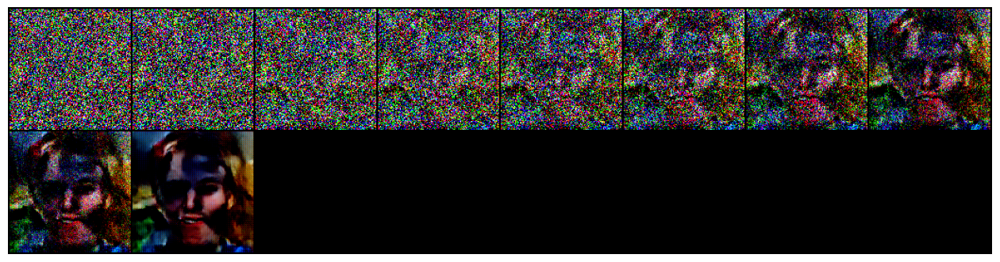

E50S1
E50S2
E50S3
E50S4
E50S5
E50S6
E50S7
E50S8
E50S9
E50S10
E50S11
E50S12
E50S13
E50S14
E50S15
E50S16
E50S17
E50S18
E50S19
E50S20
E50S21
E50S22
E50S23
E50S24
E50S25
E50S26
E50S27
E50S28
E50S29
E50S30
E50S31
E50S32
E50S33
E50S34
E50S35
E50S36
E50S37
E50S38
E50S39
E50S40
E50S41
E50S42
E50S43
E50S44
E50S45
E50S46
E50S47
E50S48
E50S49
E50S50
E50S51
E50S52
E50S53
E50S54
E50S55
E50S56
E50S57
E50S58
E50S59
E50S60
E50S61
E50S62
E50S63
E50S64
E50S65
E50S66
E50S67
E50S68
E50S69
E50S70
E50S71
E50S72
E50S73
E50S74
E50S75
E50S76
E50S77
E50S78
E50S79
E50S80
E50S81
E50S82
E50S83
E50S84
E50S85
E50S86
E50S87
E50S88
E50S89
E50S90
E50S91
E50S92
E50S93
E50S94
E50S95
E50S96
E50S97
E50S98
E50S99
E50S100
E50S101
E50S102
E50S103
E50S104
E50S105
E50S106
E50S107
E50S108
E50S109
E50S110
E50S111
E50S112
E50S113
E50S114
E50S115
E50S116
E50S117
E50S118
E50S119
E50S120
E50S121
E50S122
E50S123
E50S124
E50S125
E50S126
E50S127
E50S128
E50S129
E50S130
E50S131
E50S132
E50S133
E50S134
E50S135
E50S136
E50S137
E50S138
E50S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


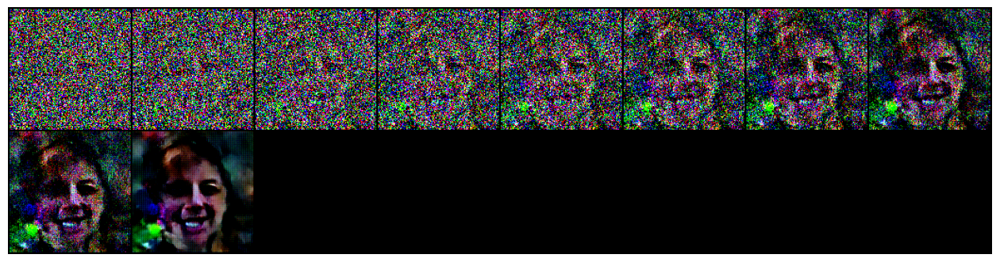

E55S1
E55S2
E55S3
E55S4
E55S5
E55S6
E55S7
E55S8
E55S9
E55S10
E55S11
E55S12
E55S13
E55S14
E55S15
E55S16
E55S17
E55S18
E55S19
E55S20
E55S21
E55S22
E55S23
E55S24
E55S25
E55S26
E55S27
E55S28
E55S29
E55S30
E55S31
E55S32
E55S33
E55S34
E55S35
E55S36
E55S37
E55S38
E55S39
E55S40
E55S41
E55S42
E55S43
E55S44
E55S45
E55S46
E55S47
E55S48
E55S49
E55S50
E55S51
E55S52
E55S53
E55S54
E55S55
E55S56
E55S57
E55S58
E55S59
E55S60
E55S61
E55S62
E55S63
E55S64
E55S65
E55S66
E55S67
E55S68
E55S69
E55S70
E55S71
E55S72
E55S73
E55S74
E55S75
E55S76
E55S77
E55S78
E55S79
E55S80
E55S81
E55S82
E55S83
E55S84
E55S85
E55S86
E55S87
E55S88
E55S89
E55S90
E55S91
E55S92
E55S93
E55S94
E55S95
E55S96
E55S97
E55S98
E55S99
E55S100
E55S101
E55S102
E55S103
E55S104
E55S105
E55S106
E55S107
E55S108
E55S109
E55S110
E55S111
E55S112
E55S113
E55S114
E55S115
E55S116
E55S117
E55S118
E55S119
E55S120
E55S121
E55S122
E55S123
E55S124
E55S125
E55S126
E55S127
E55S128
E55S129
E55S130
E55S131
E55S132
E55S133
E55S134
E55S135
E55S136
E55S137
E55S138
E55S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


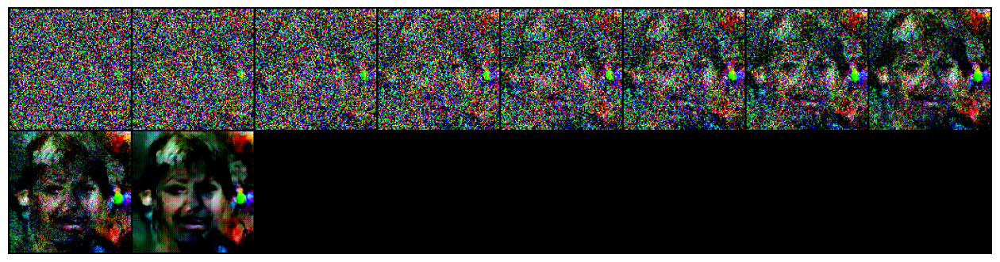

E60S1
E60S2
E60S3
E60S4
E60S5
E60S6
E60S7
E60S8
E60S9
E60S10
E60S11
E60S12
E60S13
E60S14
E60S15
E60S16
E60S17
E60S18
E60S19
E60S20
E60S21
E60S22
E60S23
E60S24
E60S25
E60S26
E60S27
E60S28
E60S29
E60S30
E60S31
E60S32
E60S33
E60S34
E60S35
E60S36
E60S37
E60S38
E60S39
E60S40
E60S41
E60S42
E60S43
E60S44
E60S45
E60S46
E60S47
E60S48
E60S49
E60S50
E60S51
E60S52
E60S53
E60S54
E60S55
E60S56
E60S57
E60S58
E60S59
E60S60
E60S61
E60S62
E60S63
E60S64
E60S65
E60S66
E60S67
E60S68
E60S69
E60S70
E60S71
E60S72
E60S73
E60S74
E60S75
E60S76
E60S77
E60S78
E60S79
E60S80
E60S81
E60S82
E60S83
E60S84
E60S85
E60S86
E60S87
E60S88
E60S89
E60S90
E60S91
E60S92
E60S93
E60S94
E60S95
E60S96
E60S97
E60S98
E60S99
E60S100
E60S101
E60S102
E60S103
E60S104
E60S105
E60S106
E60S107
E60S108
E60S109
E60S110
E60S111
E60S112
E60S113
E60S114
E60S115
E60S116
E60S117
E60S118
E60S119
E60S120
E60S121
E60S122
E60S123
E60S124
E60S125
E60S126
E60S127
E60S128
E60S129
E60S130
E60S131
E60S132
E60S133
E60S134
E60S135
E60S136
E60S137
E60S138
E60S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


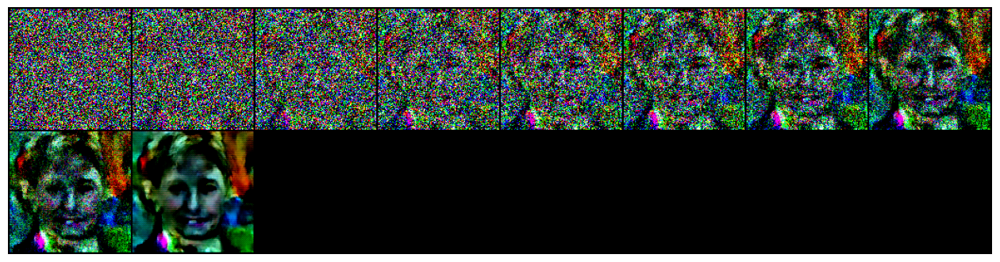

E65S1
E65S2
E65S3
E65S4
E65S5
E65S6
E65S7
E65S8
E65S9
E65S10
E65S11
E65S12
E65S13
E65S14
E65S15
E65S16
E65S17
E65S18
E65S19
E65S20
E65S21
E65S22
E65S23
E65S24
E65S25
E65S26
E65S27
E65S28
E65S29
E65S30
E65S31
E65S32
E65S33
E65S34
E65S35
E65S36
E65S37
E65S38
E65S39
E65S40
E65S41
E65S42
E65S43
E65S44
E65S45
E65S46
E65S47
E65S48
E65S49
E65S50
E65S51
E65S52
E65S53
E65S54
E65S55
E65S56
E65S57
E65S58
E65S59
E65S60
E65S61
E65S62
E65S63
E65S64
E65S65
E65S66
E65S67
E65S68
E65S69
E65S70
E65S71
E65S72
E65S73
E65S74
E65S75
E65S76
E65S77
E65S78
E65S79
E65S80
E65S81
E65S82
E65S83
E65S84
E65S85
E65S86
E65S87
E65S88
E65S89
E65S90
E65S91
E65S92
E65S93
E65S94
E65S95
E65S96
E65S97
E65S98
E65S99
E65S100
E65S101
E65S102
E65S103
E65S104
E65S105
E65S106
E65S107
E65S108
E65S109
E65S110
E65S111
E65S112
E65S113
E65S114
E65S115
E65S116
E65S117
E65S118
E65S119
E65S120
E65S121
E65S122
E65S123
E65S124
E65S125
E65S126
E65S127
E65S128
E65S129
E65S130
E65S131
E65S132
E65S133
E65S134
E65S135
E65S136
E65S137
E65S138
E65S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


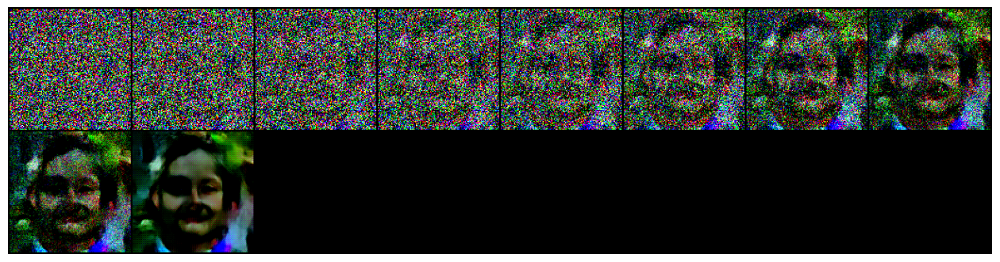

E70S1
E70S2
E70S3
E70S4
E70S5
E70S6
E70S7
E70S8
E70S9
E70S10
E70S11
E70S12
E70S13
E70S14
E70S15
E70S16
E70S17
E70S18
E70S19
E70S20
E70S21
E70S22
E70S23
E70S24
E70S25
E70S26
E70S27
E70S28
E70S29
E70S30
E70S31
E70S32
E70S33
E70S34
E70S35
E70S36
E70S37
E70S38
E70S39
E70S40
E70S41
E70S42
E70S43
E70S44
E70S45
E70S46
E70S47
E70S48
E70S49
E70S50
E70S51
E70S52
E70S53
E70S54
E70S55
E70S56
E70S57
E70S58
E70S59
E70S60
E70S61
E70S62
E70S63
E70S64
E70S65
E70S66
E70S67
E70S68
E70S69
E70S70
E70S71
E70S72
E70S73
E70S74
E70S75
E70S76
E70S77
E70S78
E70S79
E70S80
E70S81
E70S82
E70S83
E70S84
E70S85
E70S86
E70S87
E70S88
E70S89
E70S90
E70S91
E70S92
E70S93
E70S94
E70S95
E70S96
E70S97
E70S98
E70S99
E70S100
E70S101
E70S102
E70S103
E70S104
E70S105
E70S106
E70S107
E70S108
E70S109
E70S110
E70S111
E70S112
E70S113
E70S114
E70S115
E70S116
E70S117
E70S118
E70S119
E70S120
E70S121
E70S122
E70S123
E70S124
E70S125
E70S126
E70S127
E70S128
E70S129
E70S130
E70S131
E70S132
E70S133
E70S134
E70S135
E70S136
E70S137
E70S138
E70S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


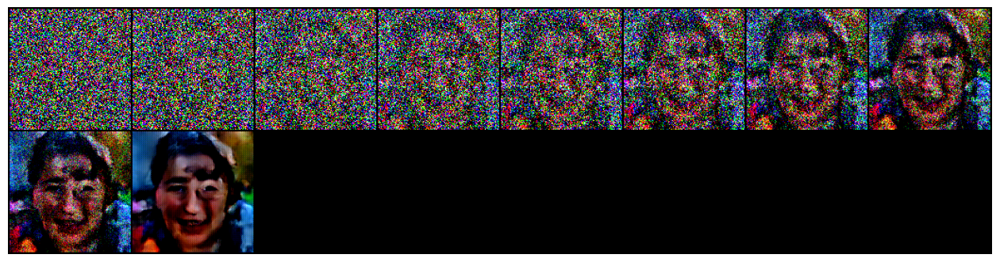

E75S1
E75S2
E75S3
E75S4
E75S5
E75S6
E75S7
E75S8
E75S9
E75S10
E75S11
E75S12
E75S13
E75S14
E75S15
E75S16
E75S17
E75S18
E75S19
E75S20
E75S21
E75S22
E75S23
E75S24
E75S25
E75S26
E75S27
E75S28
E75S29
E75S30
E75S31
E75S32
E75S33
E75S34
E75S35
E75S36
E75S37
E75S38
E75S39
E75S40
E75S41
E75S42
E75S43
E75S44
E75S45
E75S46
E75S47
E75S48
E75S49
E75S50
E75S51
E75S52
E75S53
E75S54
E75S55
E75S56
E75S57
E75S58
E75S59
E75S60
E75S61
E75S62
E75S63
E75S64
E75S65
E75S66
E75S67
E75S68
E75S69
E75S70
E75S71
E75S72
E75S73
E75S74
E75S75
E75S76
E75S77
E75S78
E75S79
E75S80
E75S81
E75S82
E75S83
E75S84
E75S85
E75S86
E75S87
E75S88
E75S89
E75S90
E75S91
E75S92
E75S93
E75S94
E75S95
E75S96
E75S97
E75S98
E75S99
E75S100
E75S101
E75S102
E75S103
E75S104
E75S105
E75S106
E75S107
E75S108
E75S109
E75S110
E75S111
E75S112
E75S113
E75S114
E75S115
E75S116
E75S117
E75S118
E75S119
E75S120
E75S121
E75S122
E75S123
E75S124
E75S125
E75S126
E75S127
E75S128
E75S129
E75S130
E75S131
E75S132
E75S133
E75S134
E75S135
E75S136
E75S137
E75S138
E75S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


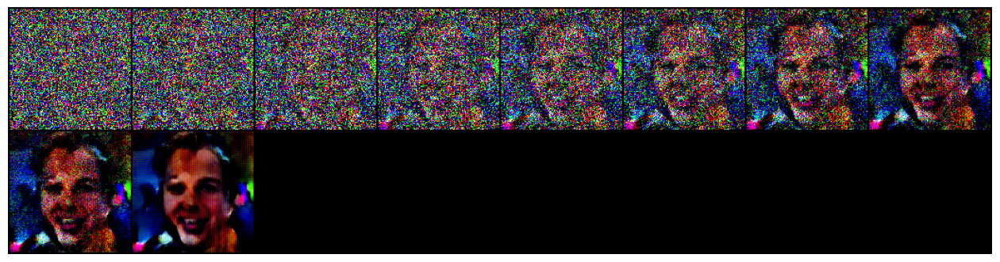

E80S1
E80S2
E80S3
E80S4
E80S5
E80S6
E80S7
E80S8
E80S9
E80S10
E80S11
E80S12
E80S13
E80S14
E80S15
E80S16
E80S17
E80S18
E80S19
E80S20
E80S21
E80S22
E80S23
E80S24
E80S25
E80S26
E80S27
E80S28
E80S29
E80S30
E80S31
E80S32
E80S33
E80S34
E80S35
E80S36
E80S37
E80S38
E80S39
E80S40
E80S41
E80S42
E80S43
E80S44
E80S45
E80S46
E80S47
E80S48
E80S49
E80S50
E80S51
E80S52
E80S53
E80S54
E80S55
E80S56
E80S57
E80S58
E80S59
E80S60
E80S61
E80S62
E80S63
E80S64
E80S65
E80S66
E80S67
E80S68
E80S69
E80S70
E80S71
E80S72
E80S73
E80S74
E80S75
E80S76
E80S77
E80S78
E80S79
E80S80
E80S81
E80S82
E80S83
E80S84
E80S85
E80S86
E80S87
E80S88
E80S89
E80S90
E80S91
E80S92
E80S93
E80S94
E80S95
E80S96
E80S97
E80S98
E80S99
E80S100
E80S101
E80S102
E80S103
E80S104
E80S105
E80S106
E80S107
E80S108
E80S109
E80S110
E80S111
E80S112
E80S113
E80S114
E80S115
E80S116
E80S117
E80S118
E80S119
E80S120
E80S121
E80S122
E80S123
E80S124
E80S125
E80S126
E80S127
E80S128
E80S129
E80S130
E80S131
E80S132
E80S133
E80S134
E80S135
E80S136
E80S137
E80S138
E80S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


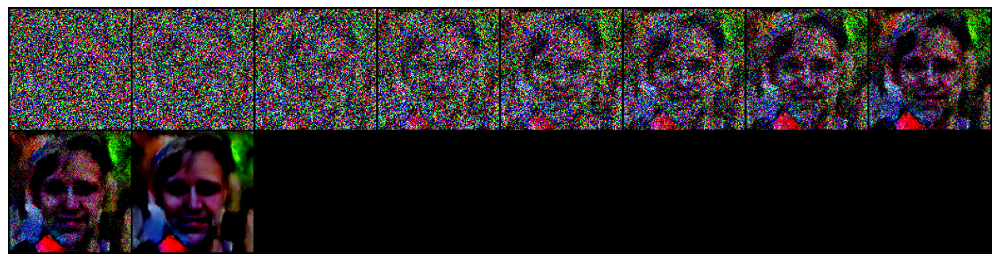

E85S1
E85S2
E85S3
E85S4
E85S5
E85S6
E85S7
E85S8
E85S9
E85S10
E85S11
E85S12
E85S13
E85S14
E85S15
E85S16
E85S17
E85S18
E85S19
E85S20
E85S21
E85S22
E85S23
E85S24
E85S25
E85S26
E85S27
E85S28
E85S29
E85S30
E85S31
E85S32
E85S33
E85S34
E85S35
E85S36
E85S37
E85S38
E85S39
E85S40
E85S41
E85S42
E85S43
E85S44
E85S45
E85S46
E85S47
E85S48
E85S49
E85S50
E85S51
E85S52
E85S53
E85S54
E85S55
E85S56
E85S57
E85S58
E85S59
E85S60
E85S61
E85S62
E85S63
E85S64
E85S65
E85S66
E85S67
E85S68
E85S69
E85S70
E85S71
E85S72
E85S73
E85S74
E85S75
E85S76
E85S77
E85S78
E85S79
E85S80
E85S81
E85S82
E85S83
E85S84
E85S85
E85S86
E85S87
E85S88
E85S89
E85S90
E85S91
E85S92
E85S93
E85S94
E85S95
E85S96
E85S97
E85S98
E85S99
E85S100
E85S101
E85S102
E85S103
E85S104
E85S105
E85S106
E85S107
E85S108
E85S109
E85S110
E85S111
E85S112
E85S113
E85S114
E85S115
E85S116
E85S117
E85S118
E85S119
E85S120
E85S121
E85S122
E85S123
E85S124
E85S125
E85S126
E85S127
E85S128
E85S129
E85S130
E85S131
E85S132
E85S133
E85S134
E85S135
E85S136
E85S137
E85S138
E85S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


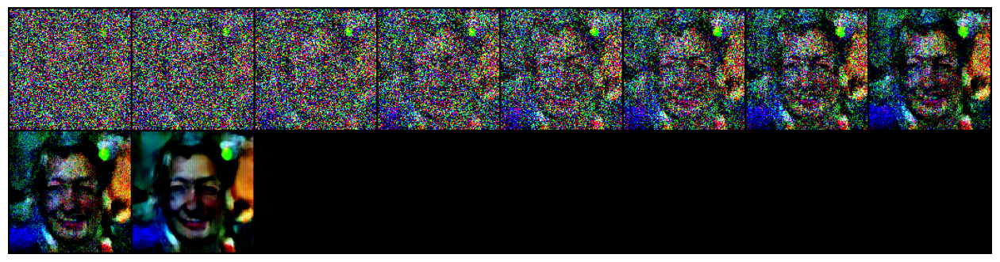

E90S1
E90S2
E90S3
E90S4
E90S5
E90S6
E90S7
E90S8
E90S9
E90S10
E90S11
E90S12
E90S13
E90S14
E90S15
E90S16
E90S17
E90S18
E90S19
E90S20
E90S21
E90S22
E90S23
E90S24
E90S25
E90S26
E90S27
E90S28
E90S29
E90S30
E90S31
E90S32
E90S33
E90S34
E90S35
E90S36
E90S37
E90S38
E90S39
E90S40
E90S41
E90S42
E90S43
E90S44
E90S45
E90S46
E90S47
E90S48
E90S49
E90S50
E90S51
E90S52
E90S53
E90S54
E90S55
E90S56
E90S57
E90S58
E90S59
E90S60
E90S61
E90S62
E90S63
E90S64
E90S65
E90S66
E90S67
E90S68
E90S69
E90S70
E90S71
E90S72
E90S73
E90S74
E90S75
E90S76
E90S77
E90S78
E90S79
E90S80
E90S81
E90S82
E90S83
E90S84
E90S85
E90S86
E90S87
E90S88
E90S89
E90S90
E90S91
E90S92
E90S93
E90S94
E90S95
E90S96
E90S97
E90S98
E90S99
E90S100
E90S101
E90S102
E90S103
E90S104
E90S105
E90S106
E90S107
E90S108
E90S109
E90S110
E90S111
E90S112
E90S113
E90S114
E90S115
E90S116
E90S117
E90S118
E90S119
E90S120
E90S121
E90S122
E90S123
E90S124
E90S125
E90S126
E90S127
E90S128
E90S129
E90S130
E90S131
E90S132
E90S133
E90S134
E90S135
E90S136
E90S137
E90S138
E90S

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


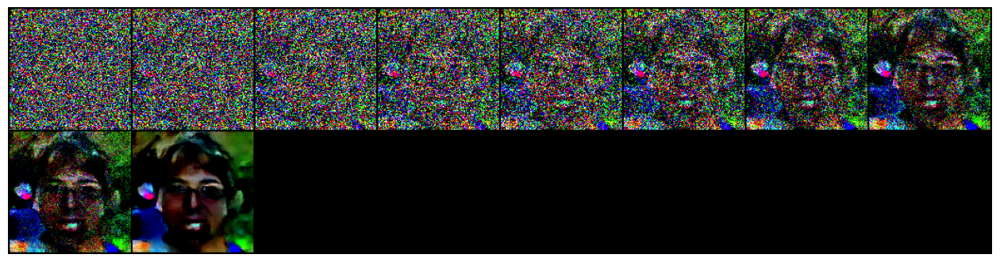

E95S1
E95S2
E95S3
E95S4
E95S5
E95S6
E95S7
E95S8
E95S9
E95S10
E95S11
E95S12
E95S13
E95S14
E95S15
E95S16
E95S17
E95S18
E95S19
E95S20
E95S21
E95S22
E95S23
E95S24
E95S25
E95S26
E95S27
E95S28
E95S29
E95S30
E95S31
E95S32
E95S33
E95S34
E95S35
E95S36
E95S37
E95S38
E95S39
E95S40
E95S41
E95S42
E95S43
E95S44
E95S45
E95S46
E95S47
E95S48
E95S49
E95S50
E95S51
E95S52
E95S53
E95S54
E95S55
E95S56
E95S57
E95S58
E95S59
E95S60
E95S61
E95S62
E95S63
E95S64
E95S65
E95S66
E95S67
E95S68
E95S69
E95S70
E95S71
E95S72
E95S73
E95S74
E95S75
E95S76
E95S77
E95S78
E95S79
E95S80
E95S81
E95S82
E95S83
E95S84
E95S85
E95S86
E95S87
E95S88
E95S89
E95S90
E95S91
E95S92
E95S93
E95S94
E95S95
E95S96
E95S97
E95S98
E95S99
E95S100
E95S101
E95S102
E95S103
E95S104
E95S105
E95S106
E95S107
E95S108
E95S109
E95S110
E95S111
E95S112
E95S113
E95S114
E95S115
E95S116
E95S117
E95S118
E95S119
E95S120
E95S121
E95S122
E95S123
E95S124
E95S125
E95S126
E95S127
E95S128
E95S129
E95S130
E95S131
E95S132
E95S133
E95S134
E95S135
E95S136
E95S137
E95S138
E95S

In [13]:
from torch.optim import Adam

model = SimpleUnet().to(device)
# model.load_state_dict(torch.load('model.pt'))
optimizer = Adam(model.parameters(), lr=0.001)
# optimizer = Adam(model.parameters())
epochs = 100 # Try more!

for epoch in range(epochs):
  print(f'E{epoch}')
  for step, batch in enumerate(dataloader):
    optimizer.zero_grad()

    t = torch.randint(0, T, (1,), device=device)
    loss = get_loss(model, batch[0], t)
    loss.backward()
    optimizer.step()

    if epoch % 5 == 0 and step == 0:
      print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
      sample_plot_image(model)

In [78]:
torch.save(model.state_dict(), 'model.pt')
# torch.save(model.state_dict(), '../models/face_diffusion.pt')

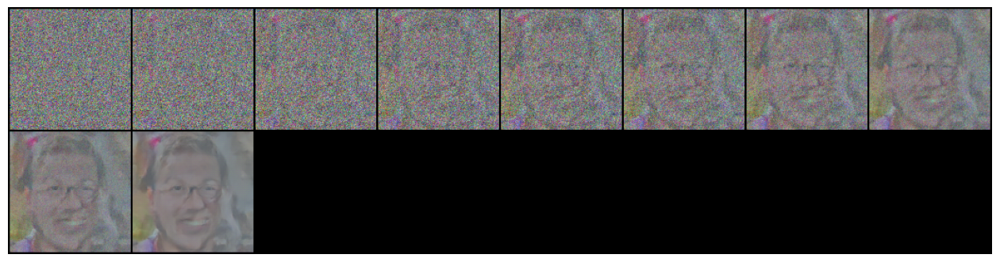

In [105]:
sample_plot_image(model)